<a href="https://colab.research.google.com/github/meichenfang/Poisson-regression/blob/main/demos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<font size="+4"><center> Demonstrations </center></font> 

# Load packages

In [1]:
%cd ../RADOM

# restrict numpy to use only one core, otherwise it will use all cores when doing @
import os
os.environ["BLAS_NUM_THREADS"] = "1" 
os.environ["OPENBLAS_NUM_THREADS"] = "1" # 


from inference import Trajectory
from plotting import *
from models.two_species_ss import get_Y

/home/mffang/workspace/Poisson-regression/RADOM


In [2]:
import numpy as np
import pickle
from tqdm import tqdm
import matplotlib.pyplot as plt
from scipy import stats
import copy
plt.rcParams['font.size'] = '24'
label_font = '36'

In [3]:
%cd ../data
results_dir = 'benchmarks_ss_results/'

/home/mffang/workspace/Poisson-regression/data


# A simple case

In [4]:
def simulate_data(topo, tau, n, p, loga_max=4, logb_max=3, random_seed=42):
    np.random.seed(random_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    t=np.linspace(tau[0],tau[-1],n)
    true_t = []
    
    theta=np.zeros((p,n_states+3))
    for j in range(n_states+1):
        theta[:,j]=np.exp(np.random.uniform(0,loga_max,size=p))-1+1e-3
    theta[:,-2:]=np.exp(np.random.uniform(0,logb_max,size=(p,2)))
    
    Y = np.zeros((n*L,p,2))
    for l in range(L):
        theta_l = np.concatenate((theta[:,topo[l]], theta[:,-3:]), axis=1)
        Y[l*n:(l+1)*n] = get_Y(theta_l,t,tau) # m*p*2
        true_t = np.append(true_t,t)

    X = np.random.poisson(Y)
    return theta, true_t, Y, X,

In [66]:
#%% generate data
n=1000
p=30
topo = np.array([[0,]])
tau = (0,1)
true_theta, t, Y, X = simulate_data(topo,tau,n=n,p=p,random_seed=2022)
#true_theta, t, Y, X = simulate_data_null(topo,tau,n=2000,true_p=50,null_p=50,random_seed=2023)

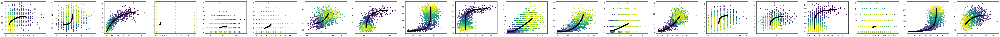

In [9]:
t = np.linspace(tau[0],tau[-1],n)
p = 20
fig, ax = plt.subplots(1,p,figsize=(6*p,4))
for i in range(p):
    #ax[i].plot(Y[:,i,1]*gamma[i],Y[:,i,1],'--', color='gray');
    ax[i].scatter(X[:,i,0],X[:,i,1],c=t);
    ax[i].scatter(Y[:,i,0],Y[:,i,1],c='black');
# time increases from blue to red

In [10]:
traj = Trajectory(topo, tau, model="two_species_ss", verbose=1)
res = traj.fit(X,m=100,n_init=3,epoch=10,parallel=True,n_threads=10)

run method fit_multi_init
trial 1


100%|██████████| 10/10 [00:01<00:00,  7.81it/s]

trial 2



100%|██████████| 10/10 [00:01<00:00,  8.14it/s]

trial 3



100%|██████████| 10/10 [00:01<00:00,  8.08it/s]


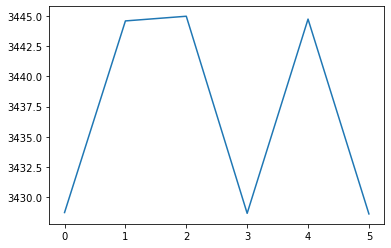

In [11]:
plt.plot(res[1]);

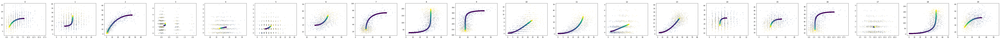

In [12]:
plot_phase(traj,idx=np.arange(20))

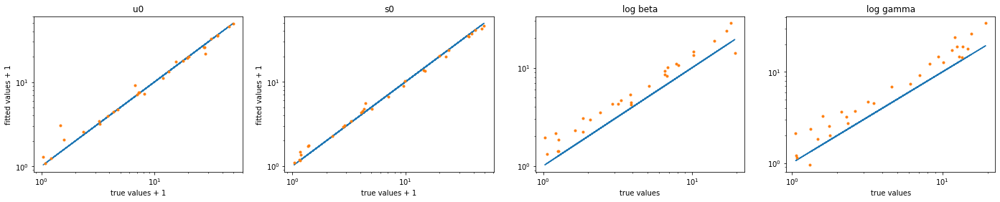

In [13]:
plot_theta(true_theta,traj.theta)

run method fit_multi_init
trial 1


 29%|██▉       | 29/100 [00:03<00:07,  8.97it/s]

trial 2



 22%|██▏       | 22/100 [00:02<00:08,  8.95it/s]

trial 3



 21%|██        | 21/100 [00:02<00:09,  8.75it/s]


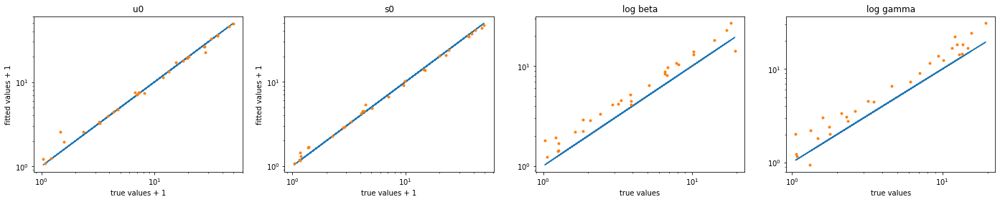

In [15]:
traj = Trajectory(topo, tau,  model="two_species_ss", verbose=1)
res = traj.fit(X,m=100,n_init=3,epoch=100,parallel=True,n_threads=10)
plot_theta(true_theta,traj.theta)

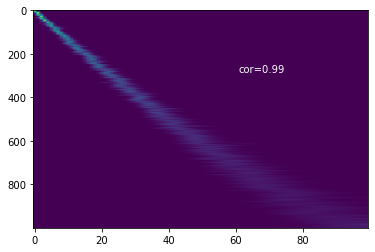

In [16]:
plot_t(res[0],t=t)

# Vary p, n and topo

## Functions

### Fit

In [5]:
from multiprocessing import Pool

def fit_wrapper(X,topo_,tau_,true_t,theta,m,n_init):
    traj = Trajectory(topo=topo_, tau=tau_, model="two_species_ss")
    traj.fit(X,m=m,n_init=n_init,epoch=100,parallel=False)   
            
    traj.true_t = true_t
    traj.true_theta = theta
    
    return traj

In [6]:
def fit_vary_n_fixed(topo, tau, ns=[100,316,1000,3162,10000], p=100, seed=2022, K=10, n_init=3, epoch=100, m=100, cores=10):
    np.random.seed(seed)
    L = len(topo)     
    n_states=len(set(topo.flatten()))
    loga_max = 4
    logb_max = 3
    theta=np.zeros((p,n_states+3))
    for j in range(n_states+1):
        theta[:,j]=np.exp(np.random.uniform(0,loga_max,size=p))-1+1e-3
    theta[:,-2]=np.exp(np.random.uniform(0,logb_max,size=p))
    theta[:,-1]=np.exp(np.random.uniform(0,logb_max,size=p))
    
    Input_args = []
    for i,n in enumerate(ns):             
        for k in range(K):
            np.random.seed(k)
            true_t = []
            Y = np.zeros((n*L,p,2)) 
            for l in range(L):
                t = np.sort(np.random.uniform(tau[0],tau[-1],n))
                #t = np.linspace(tau[0],tau[-1],n)
                theta_l = np.concatenate((theta[:,topo[l]], theta[:,-3:]), axis=1)
                Y[l*n:(l+1)*n] = get_Y(theta_l,t,tau) # m*p*2
                true_t = np.append(true_t,t)
        
            X = np.random.poisson(Y)
            
            Input_args.append((X, topo, tau, true_t, theta, m, n_init))
            
    with Pool(cores) as pool:      
        results = pool.starmap(fit_wrapper, Input_args,chunksize=1)
    
    return results

In [7]:
def fit_vary_p_fixed(topo, tau, n=1000, ps=[10,31,100,316,1000], seed=2022, K=10, n_init=3, epoch=100, m=100, cores=10):
    np.random.seed(seed)
    L = len(topo)     
    n_states=len(set(topo.flatten()))
    loga_max = 4
    logb_max = 3
    p_total = int( np.max(ps) )
    theta_all=np.ones((p_total,n_states+3))
    
    ## theta
    for j in range(n_states+1):
        theta_all[:,j]=np.exp(np.random.uniform(0,loga_max,size=p_total))-1+1e-3
    theta_all[:,-2]=np.exp(np.random.uniform(0,logb_max,size=p_total))
    theta_all[:,-1]=np.exp(np.random.uniform(0,logb_max,size=p_total))
    
    Input_args = []
    for i,p in enumerate(ps):   
          
        Y = np.zeros((n*L,p,2))
        theta = theta_all[:p]
        
        for k in range(K):
            np.random.seed(k)
            true_t = []
            for l in range(L):
                #t=np.linspace(tau[0],tau[-1],n)
                t = np.sort(np.random.uniform(tau[0],tau[-1],n))
                theta_l = np.concatenate((theta[:,topo[l]], theta[:,-3:]), axis=1)
                Y[l*n:(l+1)*n] = get_Y(theta_l,t,tau) # m*p*2
                true_t = np.append(true_t,t)
        
            X = np.random.poisson(Y)
            
            Input_args.append((X, topo, tau, true_t, theta, m, n_init))
        
    with Pool(cores) as pool:      
        results = pool.starmap(fit_wrapper, Input_args,chunksize=1)
                
    return results

### Plot results

In [8]:
def plot_theta_results(picklefile,K=10):
    with open(picklefile, 'rb') as f:
        results = pickle.load(f)
    test = results[0]
    p, n_theta = test.theta.shape
    fig, ax = plt.subplots(len(results)//K,n_theta,figsize=(n_theta*6,len(results)//K*5),constrained_layout=True)

    for i in range(len(results)):
        traj = results[i]
        true_theta = traj.true_theta.copy()
        Q = traj.Q
        N,p,_ = traj.X.shape
        
        if len(traj.topo)==2:
            n = N//2
            if np.sum(Q[:n,0])<np.sum(Q[:n,1]):
                true_theta[:,0] = traj.true_theta[:,1]
                true_theta[:,1] = traj.true_theta[:,0]

        for j in range(n_theta):
            ax[i//K,j].loglog(true_theta[:,j],traj.theta[:,j],'.');
            
    for i in range(len(results)//K):
        for j in range(n_theta):
            ax[i,j].loglog(true_theta[:,j],true_theta[:,j],'gray');        
            
    for j in range(n_theta-3):
        ax[0,j].set_title("α"+str(j),fontsize=label_font)    
        
    ax[0,-3].set_title("u0",fontsize=label_font)
    ax[0,-2].set_title("β",fontsize=label_font)
    ax[0,-1].set_title("γ",fontsize=label_font)
    fig.supxlabel('true value',fontsize=label_font);
    fig.supylabel('estimates',fontsize=label_font);
    return fig

In [9]:
def plot_t_results(picklefile,K=10):
    with open(picklefile, 'rb') as f:
        results = pickle.load(f)
    test = results[0]
    L = len(test.topo)
    if hasattr(test,"elbos"):
        print("n_init = ",len(test.elbos))
    fig, ax = plt.subplots(len(results)//K,L*K,figsize=(L*K*6,len(results)//K*5),constrained_layout=True)
    
    for i in range(len(results)):
        traj = results[i]
        Q = traj.Q.copy()
        N,p,_ = traj.X.shape
        n = N//L
        
        if L==2:
            if np.sum(Q[:n,0])<np.sum(Q[:n,1]):
                Q[:,0] = traj.Q[:,1]
                Q[:,1] = traj.Q[:,0]

        for l in range(L):
            plot_t(Q[n*l:n*(l+1)],l,ax=ax[i//K,L*(i%K)+l],t=traj.true_t[n*l:n*(l+1)])
            
    fig.supxlabel('time grids',fontsize=label_font);
    fig.supylabel('ordered cells',fontsize=label_font);
    return fig

In [10]:
def plot_vary_n_results(picklefile,ns=[100,316,1000,3162,10000],K=10,llim=1e-3,hlim=1e3):
    with open(picklefile, 'rb') as f:
        results = pickle.load(f)
    test = results[0]
    p, n_theta = test.theta.shape
    
    abs_err = np.zeros((len(ns),K,p,n_theta))
    rel_err = np.zeros((len(ns),K,p,n_theta))
    for i in range(len(results)):
        traj = results[i]
        true_theta = traj.true_theta.copy()
        Q = traj.Q
        n = ns[i//K]
        
        if len(traj.topo)==2:
            if np.sum(Q[:n,0])<np.sum(Q[:n,1]):
                true_theta[:,0] = traj.true_theta[:,1]
                true_theta[:,1] = traj.true_theta[:,0]
        abs_err[i//K,i%K]=np.abs(traj.theta-true_theta)
        rel_err[i//K,i%K]=np.abs(traj.theta-true_theta)/true_theta

    fig, ax = plt.subplots(1,n_theta,figsize=(n_theta*6,5),constrained_layout=True)
    for i in range(p):
        for j in range(n_theta):
            ax[j].loglog(ns,rel_err[:,:,i,j].mean(axis=1),alpha=0.1);

    for j in range(n_theta-3):
        ax[j].set_title("α"+str(j),fontsize=label_font)
        
    ax[-3].set_title("u0",fontsize=label_font)
    ax[-2].set_title("β",fontsize=label_font)
    ax[-1].set_title("γ",fontsize=label_font)
    plt.setp(ax, ylim=(llim,hlim));
    fig.supylabel('relative error',fontsize=label_font);
    fig.supxlabel('number of cells',fontsize=label_font);

    """
    fig, ax = plt.subplots(1,5,figsize=(5*6,5),constrained_layout=True)
    for j in range(5):
        ax[j].loglog(ns,rel_err[:,:,:,j].mean(axis=(1,2)));

    ax[0].set_title("α1")
    ax[1].set_title("u0")
    ax[2].set_title("s0")
    ax[3].set_title("β")
    ax[4].set_title("γ")
    plt.setp(ax, ylim=(0.1,10));
    fig.supxlabel('number of cells n');
    fig.supylabel('relative error');
    """
    return fig

In [11]:
def plot_vary_p_results(picklefile,ps=[10,31,100,316,1000],K=10,llim=1e-3,hlim=1e3):
    with open(picklefile, 'rb') as f:
        results = pickle.load(f)
    test = results[-1]
    p, n_theta = test.theta.shape

    abs_err = np.zeros((len(ps),K,p,n_theta))
    rel_err = np.zeros((len(ps),K,p,n_theta))
    for i in range(len(results)):
        traj = results[i]
        true_theta = traj.true_theta.copy()
        Q = traj.Q
        p = ps[i//K]
        N = traj.X.shape[0]
        
        if len(traj.topo)==2:
            n = N//2
            if np.sum(Q[:n,0])<np.sum(Q[:n,1]):
                true_theta[:,0] = traj.true_theta[:,1]
                true_theta[:,1] = traj.true_theta[:,0]
        
        rel_err[i//K,i%K,:p] = np.abs(traj.theta-true_theta)/true_theta

    fig, ax = plt.subplots(1,n_theta,figsize=(n_theta*6,5),constrained_layout=True)
    last_p = 0
    for i,p in enumerate(ps):
        for j in range(n_theta):
            ax[j].loglog(ps[i:],rel_err[i:,:,last_p:p,j].mean(axis=1),alpha=0.1);
        last_p = p

    for j in range(n_theta-3):
        ax[j].set_title("α"+str(j),fontsize=label_font)
    
    ax[-3].set_title("u0",fontsize=label_font)
    ax[-2].set_title("β",fontsize=label_font)
    ax[-1].set_title("γ",fontsize=label_font)
    plt.setp(ax, ylim=(llim,hlim));
    fig.supylabel('relative error',fontsize=label_font);
    fig.supxlabel('number of genes',fontsize=label_font);

    """
    fig, ax = plt.subplots(1,5,figsize=(5*6,5),constrained_layout=True)
    for j in range(5):
        ax[j].loglog(ns,rel_err[:,:,:,j].mean(axis=(1,2)));

    ax[0].set_title("α1")
    ax[1].set_title("u0")
    ax[2].set_title("s0")
    ax[3].set_title("β")
    ax[4].set_title("γ")
    plt.setp(ax, ylim=(0.1,10));
    fig.supxlabel('number of cells n');
    fig.supylabel('relative error');
    """
    return fig

## Topo 1: one lineage and one transition

### Vary n

In [138]:
topo = np.array([[0,]])
tau = (0,1)
results = fit_vary_n_fixed(topo, tau, ns=[100,316,1000,3162,10000], p=100, seed=20221129, K=10, n_init=3, epoch=100, m=100, cores=10)

with open(results_dir+'topo_1_vary_n_20221129_m100n10.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

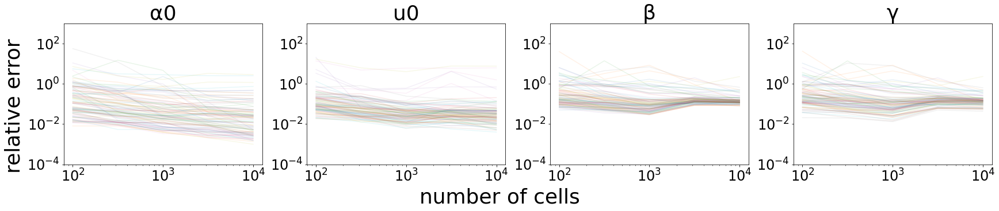

In [181]:
fig = plot_vary_n_results(results_dir+'topo_1_vary_n_2022_m100.pickle',llim=1e-4,hlim=1e3)

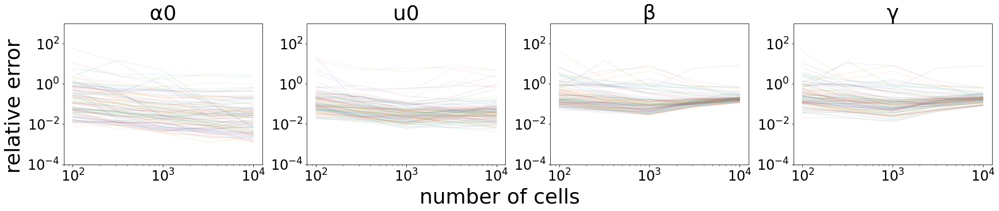

In [182]:
fig = plot_vary_n_results(results_dir+'topo_1_vary_n_2022_m100n10.pickle',llim=1e-4,hlim=1e3)

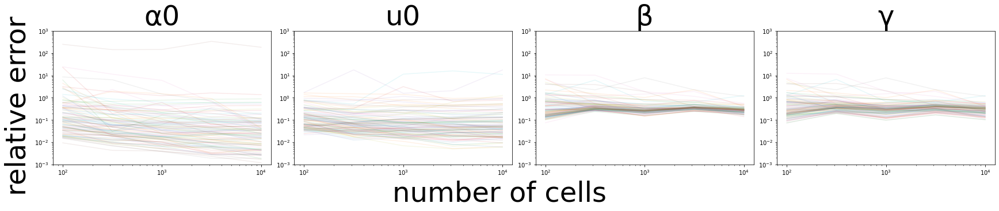

In [165]:
fig = plot_vary_n_results(results_dir+'topo_1_vary_n_20221129_m100.pickle')

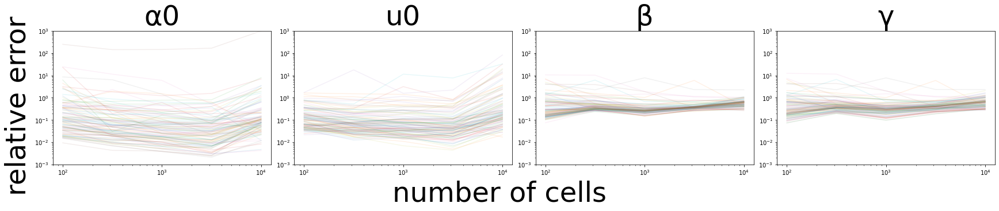

In [166]:
fig = plot_vary_n_results(results_dir+'topo_1_vary_n_20221129_m100n10.pickle')

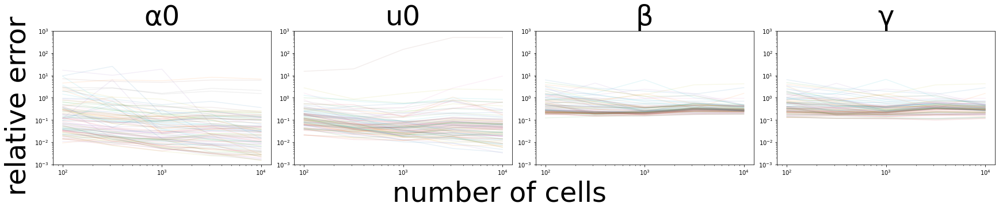

In [136]:
fig = plot_vary_n_results(results_dir+'topo_1_vary_n_20221130_m100.pickle')

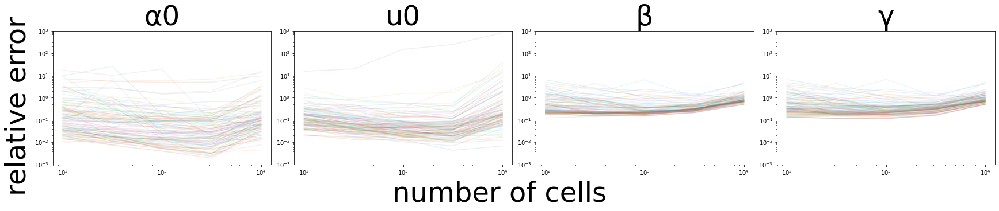

In [117]:
fig = plot_vary_n_results(results_dir+'topo_1_vary_n_20221130_m100n10.pickle')

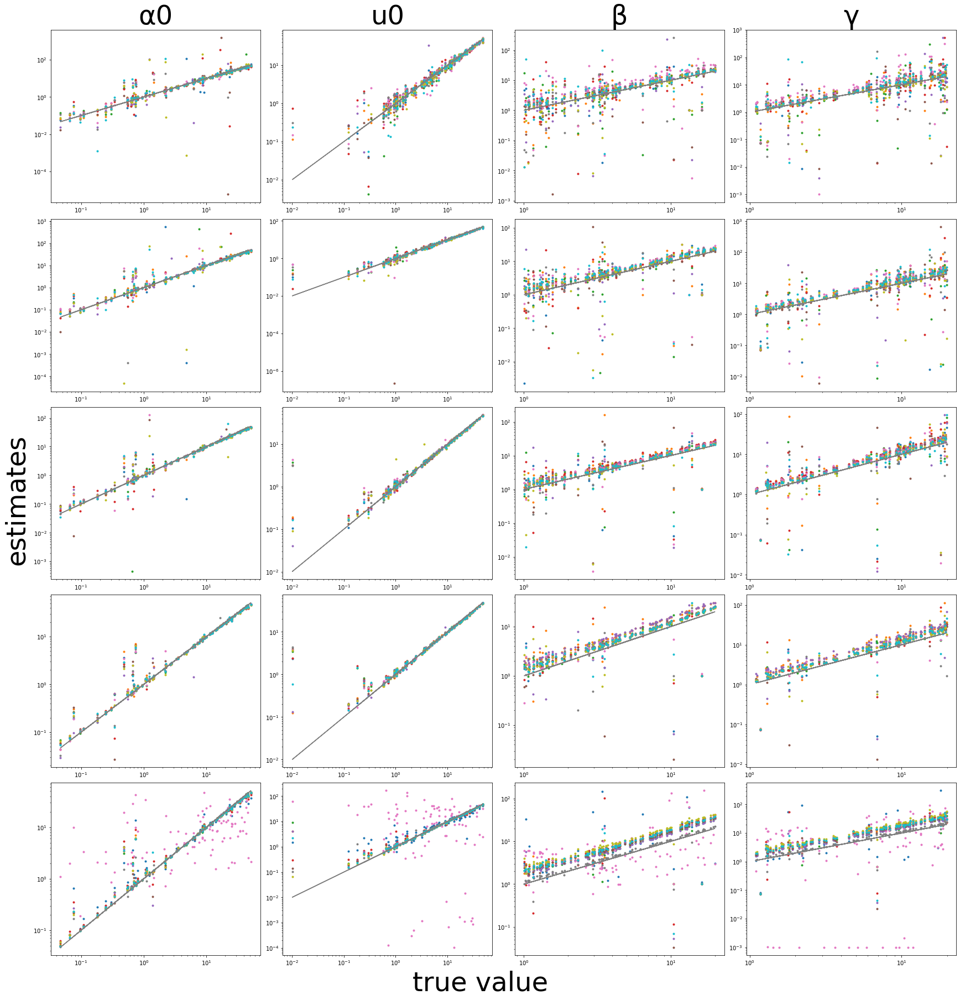

In [137]:
fig = plot_theta_results(results_dir+'topo_1_vary_n_20221130_m100n10.pickle')

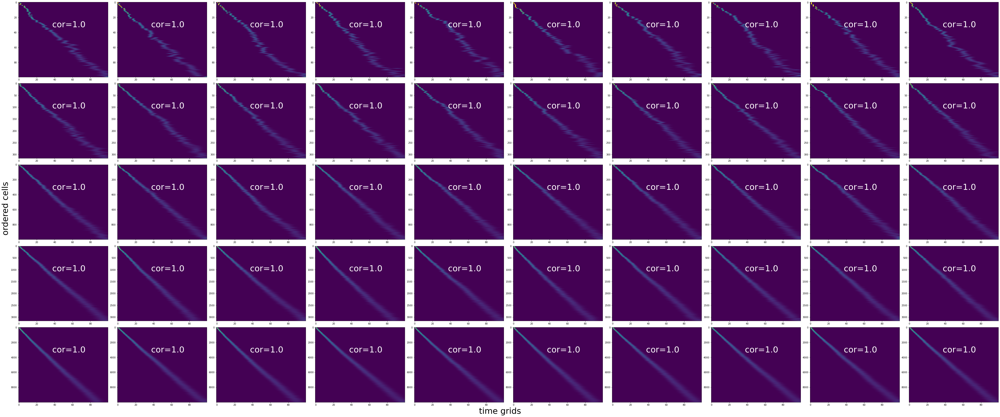

In [12]:
fig = plot_t_results(results_dir+'topo_1_vary_n_2022_m100.pickle')

n_init =  6


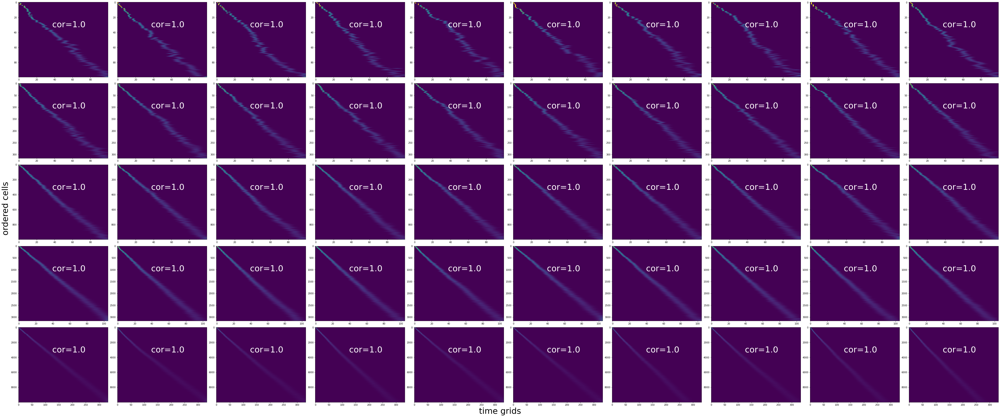

In [13]:
fig = plot_t_results(results_dir+'topo_1_vary_n_2022_m100n10.pickle')

n_init =  6


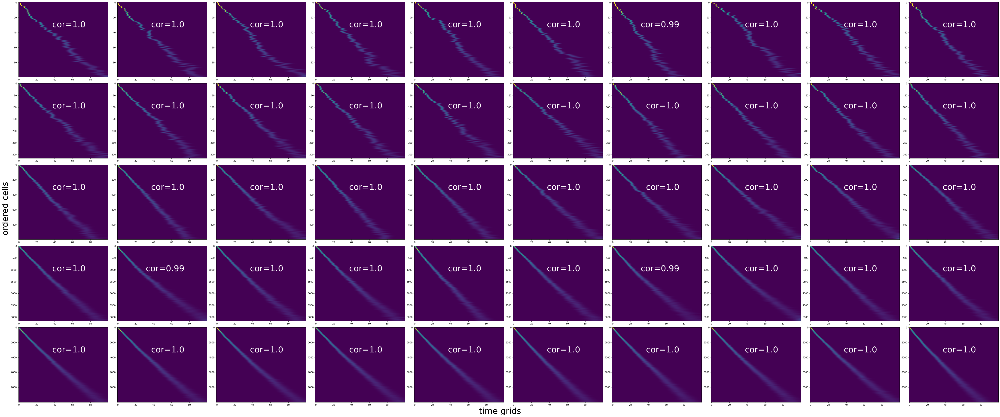

In [15]:
fig = plot_t_results(results_dir+'topo_1_vary_n_20221130_m100.pickle')

n_init =  6


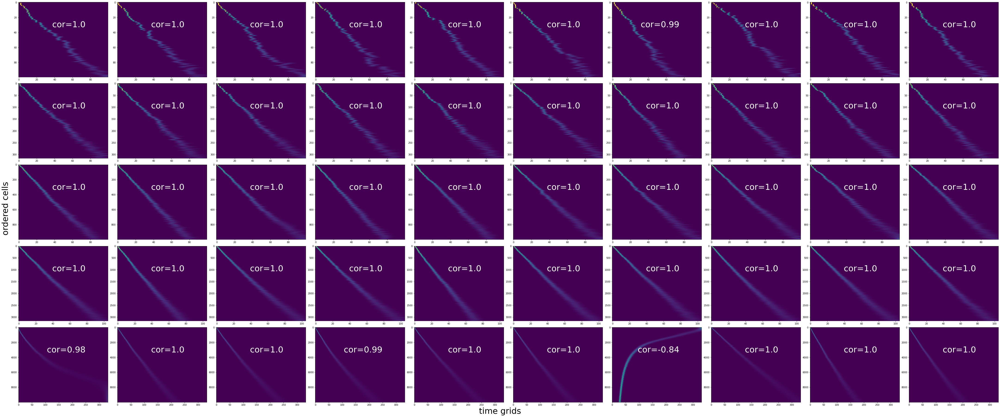

In [14]:
fig = plot_t_results(results_dir+'topo_1_vary_n_20221130_m100n10.pickle')

### Vary p

In [13]:
topo = np.array([[0,]])
tau = (0,1)
results = fit_vary_p_fixed(topo, tau, n=1000, ps=[10,31,100,316,1000], seed=20221130, K=10, n_init=3, epoch=100, m=100, cores=10)

with open(results_dir+'topo_1_vary_p_20221130.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

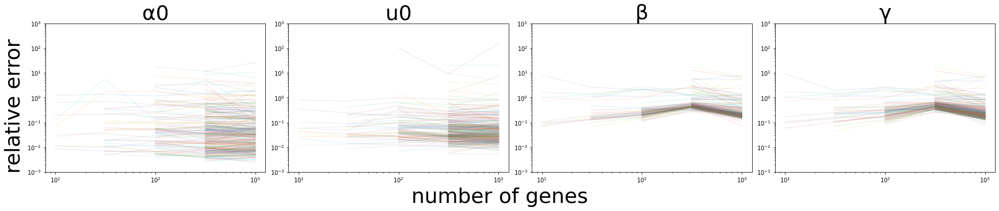

In [18]:
fig = plot_vary_p_results(results_dir+'topo_1_vary_p_2022_m100.pickle')

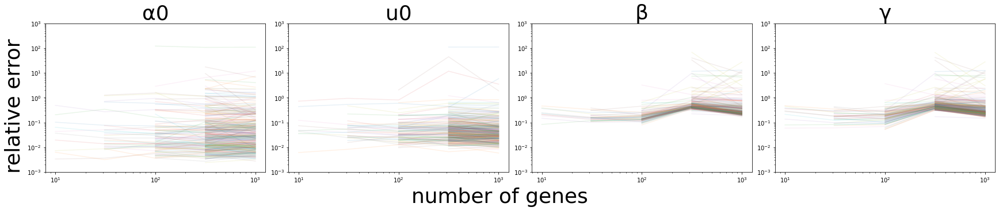

In [19]:
fig = plot_vary_p_results(results_dir+'topo_1_vary_p_20221129_m100.pickle')

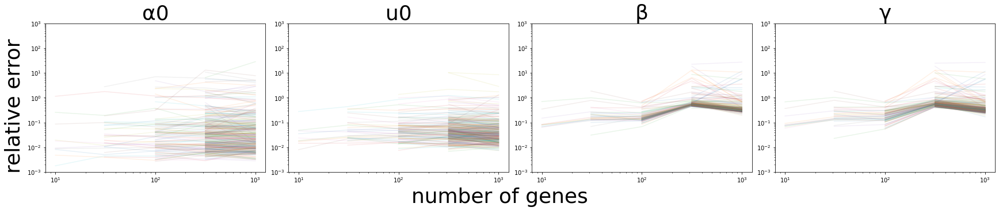

In [20]:
fig = plot_vary_p_results(results_dir+'topo_1_vary_p_20221130_m100.pickle')

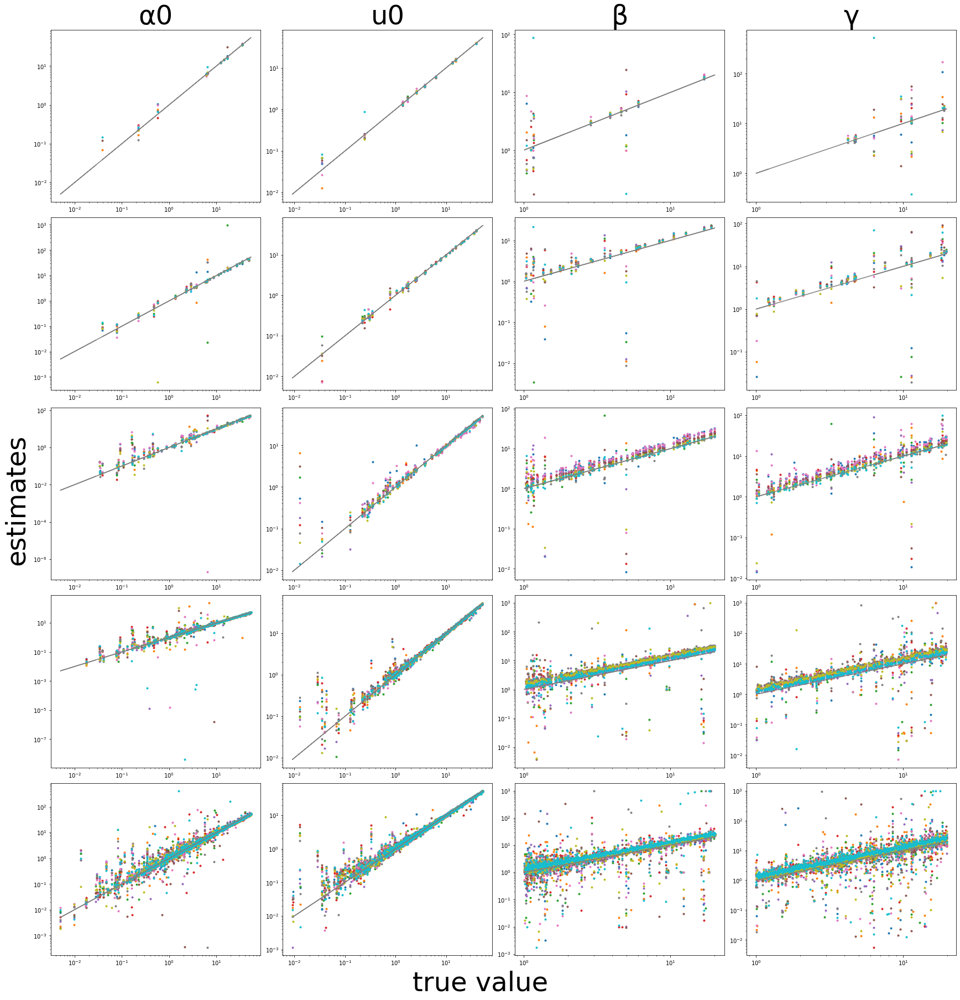

In [24]:
fig = plot_theta_results(results_dir+'topo_1_vary_p_2022.pickle')

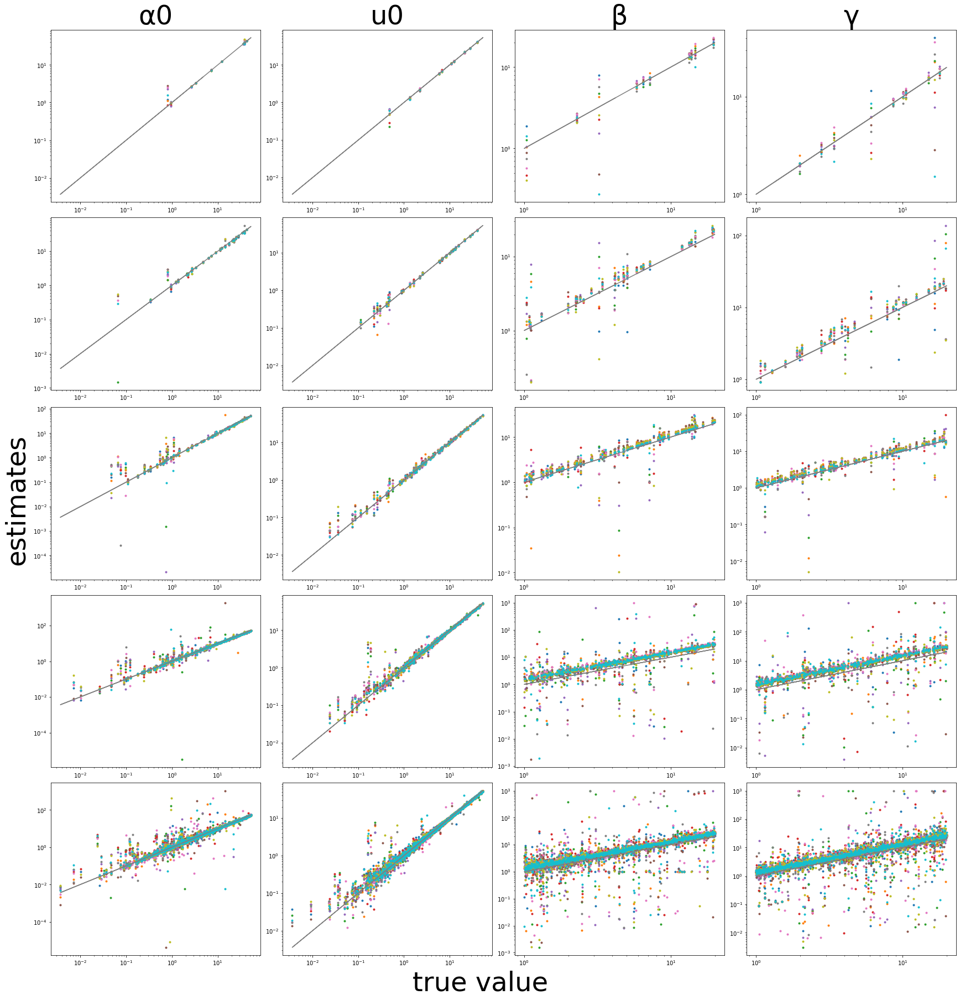

In [25]:
fig = plot_theta_results(results_dir+'topo_1_vary_p_20221130.pickle')

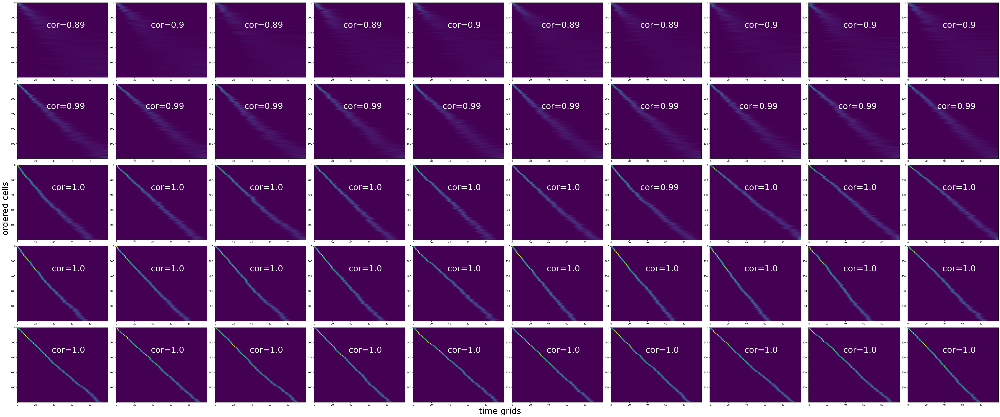

In [16]:
fig = plot_t_results(results_dir+'topo_1_vary_p_2022_m100.pickle')

n_init =  6


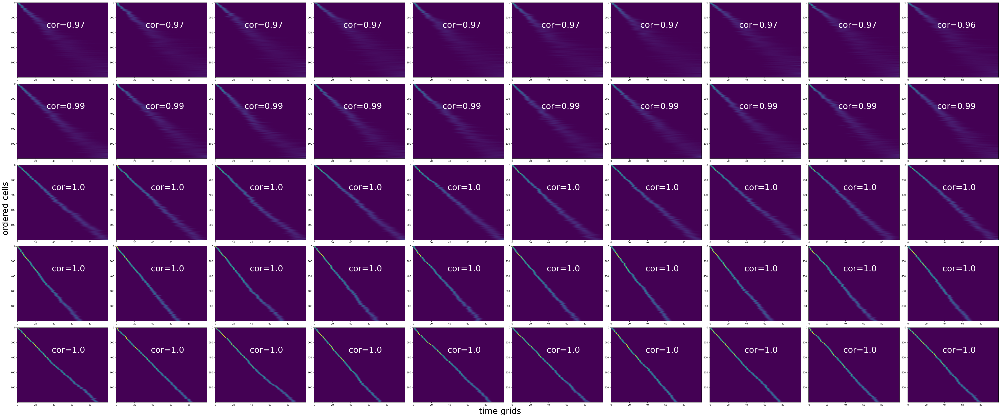

In [17]:
fig = plot_t_results(results_dir+'topo_1_vary_p_20221130_m100.pickle')

## Topo 2: one lineage with two transitions

### vary n

In [ ]:
topo = np.array([[0,1]])
tau = (0,1,2)
results = fit_vary_n_fixed(topo, tau, ns=[100,316,1000,3162,10000], p=100, seed=2022, K=10, n_init=3, epoch=100, m=200,cores=20)

with open(results_dir+'topo_2_vary_n_2022_m200.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

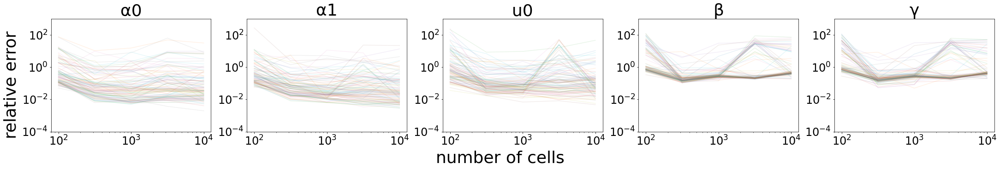

In [188]:
fig = plot_vary_n_results(results_dir+'topo_2_vary_n_20221130_m1000.pickle',llim=1e-4,hlim=1e3)

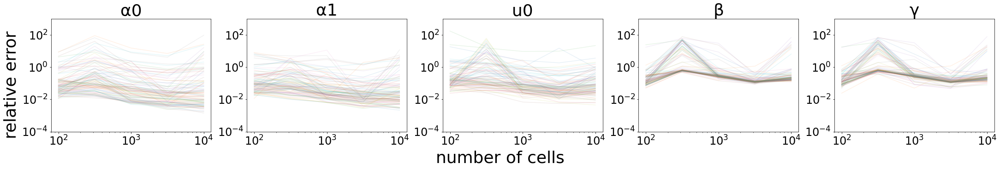

In [186]:
fig = plot_vary_n_results(results_dir+'topo_2_vary_n_20221130_mn1.pickle',llim=1e-4,hlim=1e3)

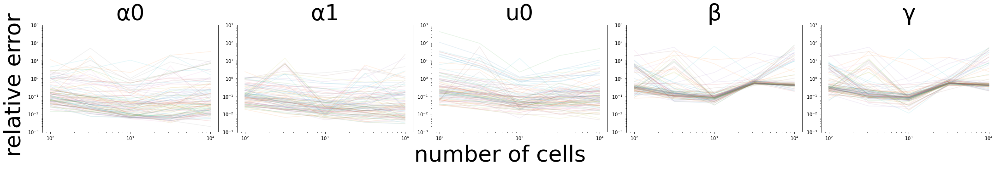

In [96]:
fig = plot_vary_n_results(results_dir+'topo_2_vary_n_20221130_mn10.pickle')

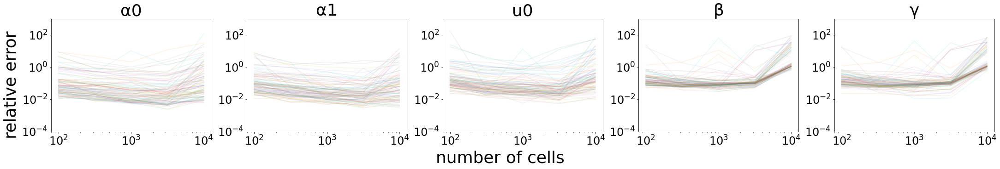

In [189]:
fig = plot_vary_n_results(results_dir+'topo_2_vary_n_20221130_m100.pickle',llim=1e-4,hlim=1e3)

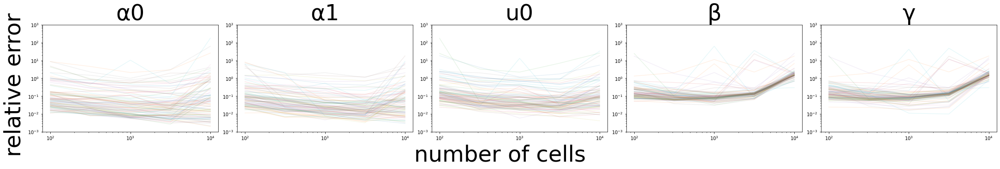

In [105]:
fig = plot_vary_n_results(results_dir+'topo_2_vary_n_20221130_m100n30.pickle')

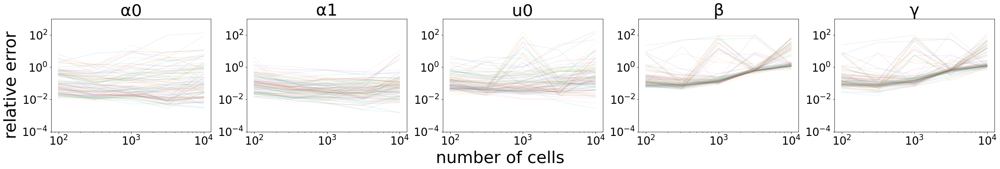

In [184]:
fig = plot_vary_n_results(results_dir+'topo_2_vary_n_2022_m100.pickle',llim=1e-4,hlim=1e3)

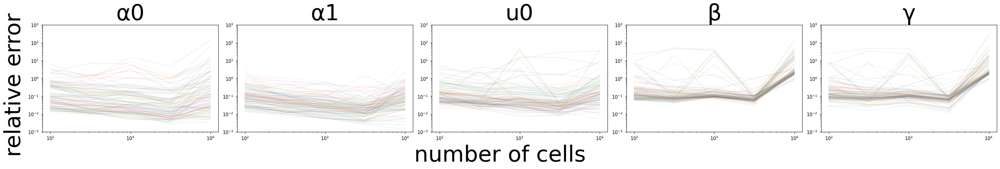

In [148]:
fig = plot_vary_n_results(results_dir+'topo_2_vary_n_2022_m100n10.pickle')

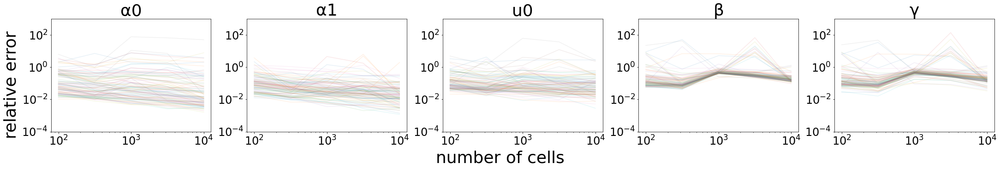

In [185]:
fig = plot_vary_n_results(results_dir+'topo_2_vary_n_2022_m100n5.pickle',llim=1e-4,hlim=1e3)

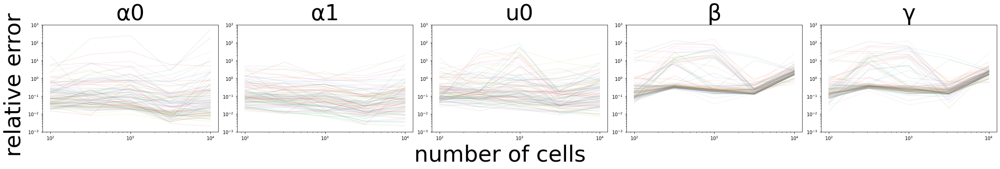

In [70]:
fig = plot_vary_n_results(results_dir+'topo_2_vary_n_20221129.pickle')

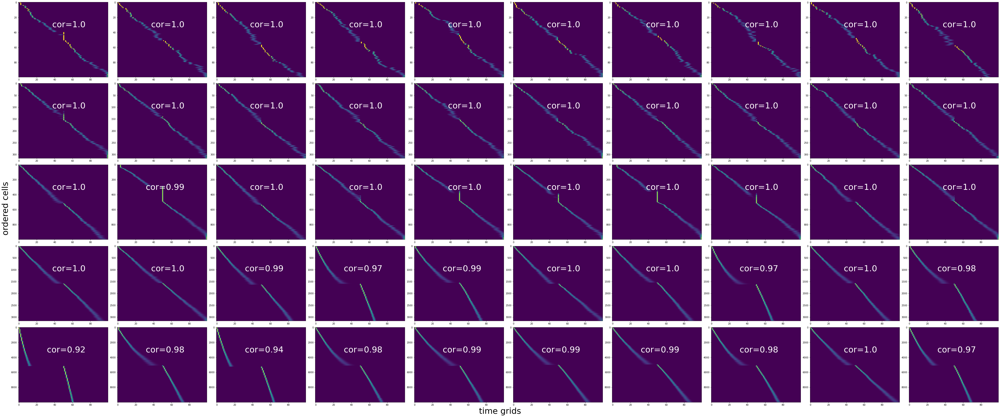

In [22]:
fig = plot_t_results(results_dir+'topo_2_vary_n_2022_m100.pickle')

n_init =  30


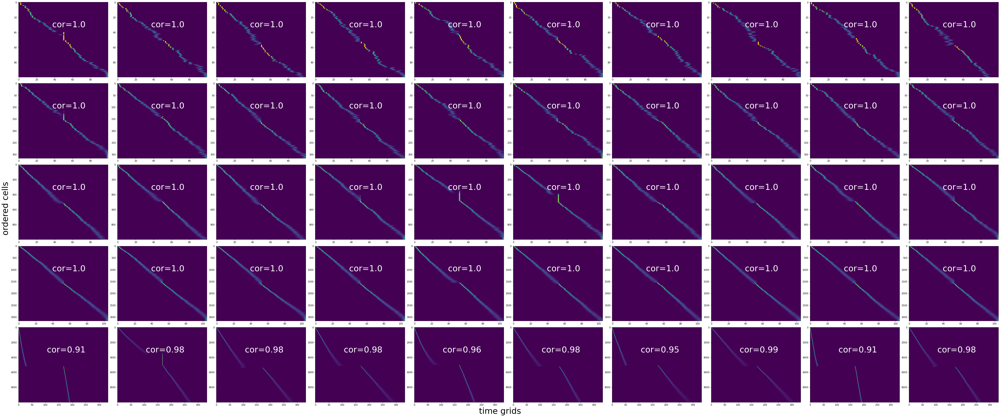

In [24]:
fig = plot_t_results(results_dir+'topo_2_vary_n_2022_m100n10.pickle')

n_init =  30


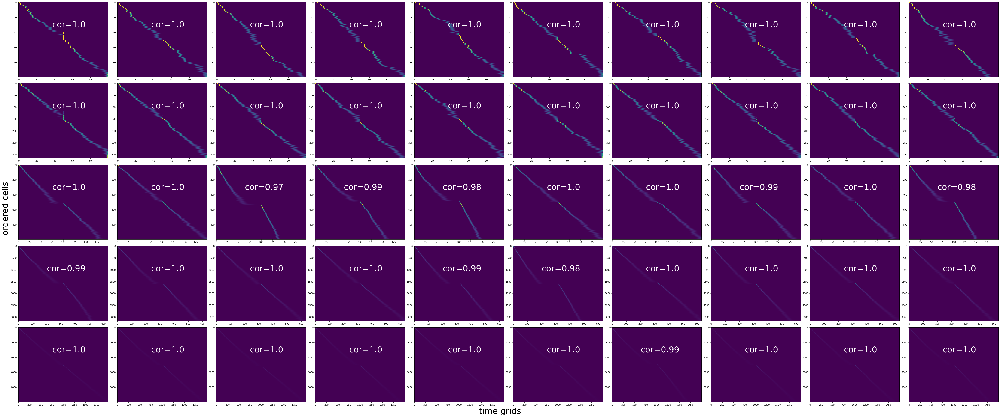

In [23]:
fig = plot_t_results(results_dir+'topo_2_vary_n_2022_m100n5.pickle')

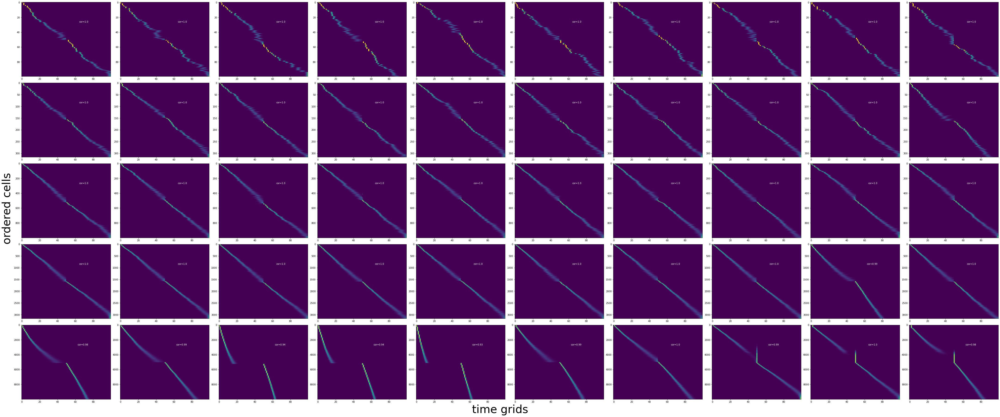

In [73]:
fig = plot_t_results(results_dir+'topo_2_vary_n_20221130.pickle')

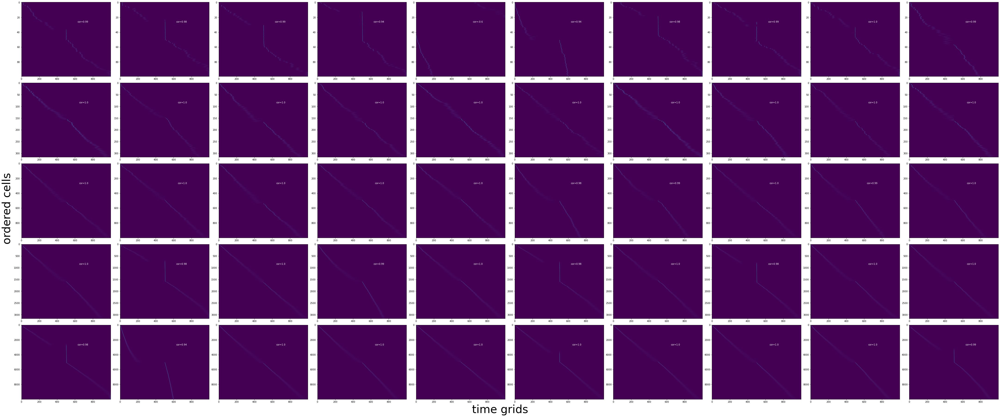

In [89]:
fig = plot_t_results(results_dir+'topo_2_vary_n_20221130_m1000.pickle')

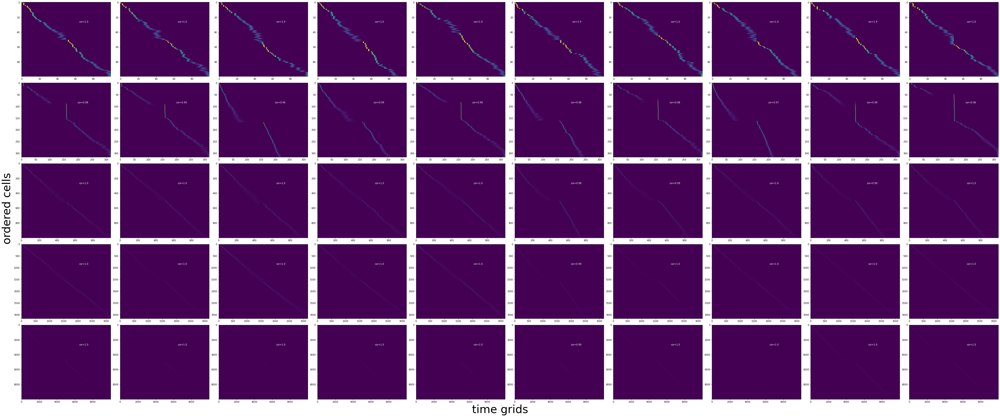

In [101]:
fig = plot_t_results(results_dir+'topo_2_vary_n_20221130_mn1.pickle')

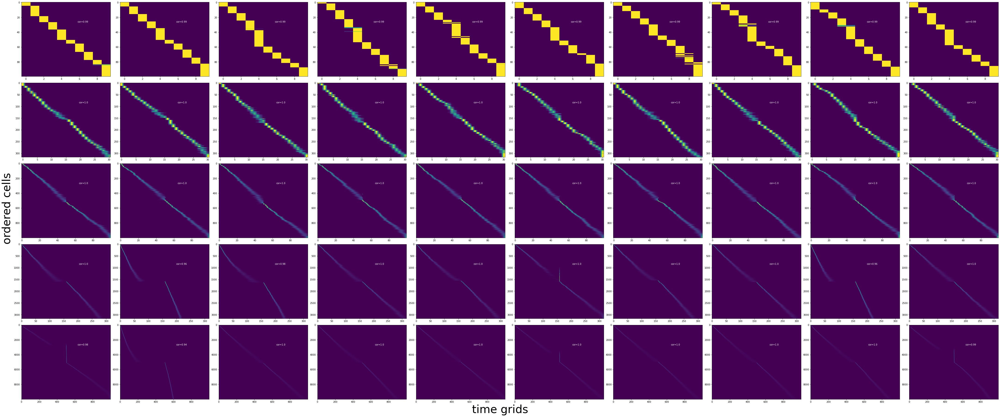

In [102]:
fig = plot_t_results(results_dir+'topo_2_vary_n_20221130_mn10.pickle')

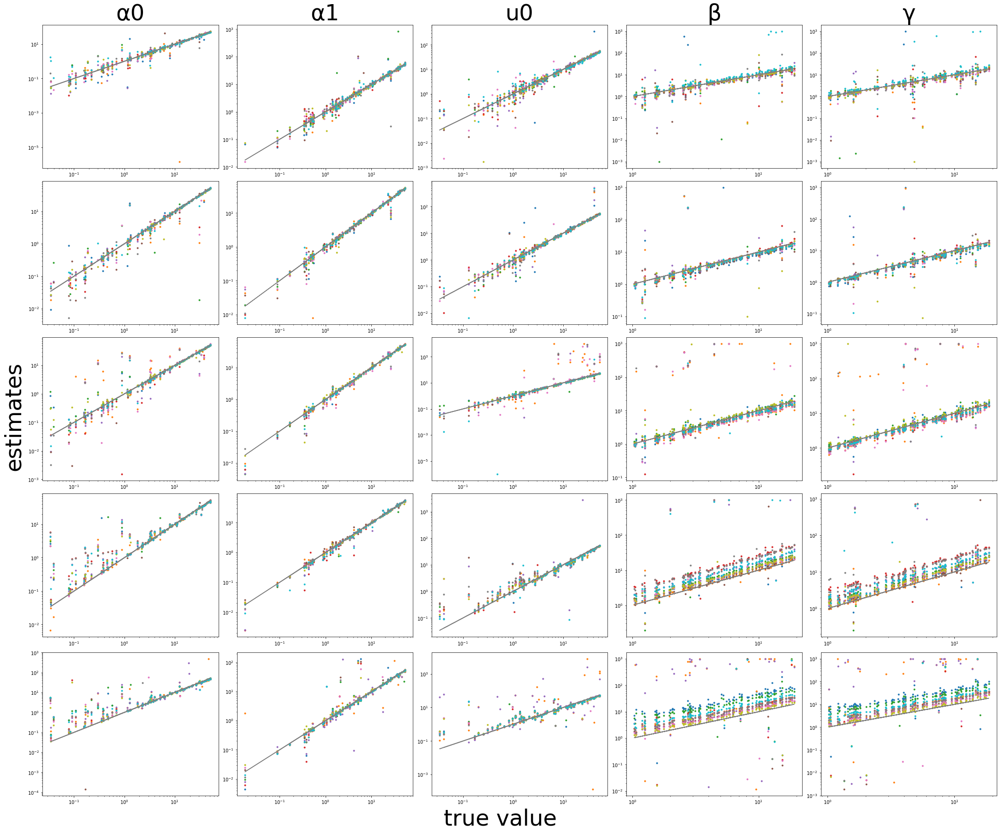

In [45]:
fig = plot_theta_results(results_dir+'topo_2_vary_n_2022.pickle')

### vary p

In [106]:
topo = np.array([[0,1]])
tau = (0,1,2)
results = fit_vary_p_fixed(topo, tau, n=2000, ps=[10,31,100,316,1000], seed=2022, K=10, n_init=3, m=1000, epoch=100, cores=10)

with open(results_dir+'topo_2_vary_p_2022_m1000.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

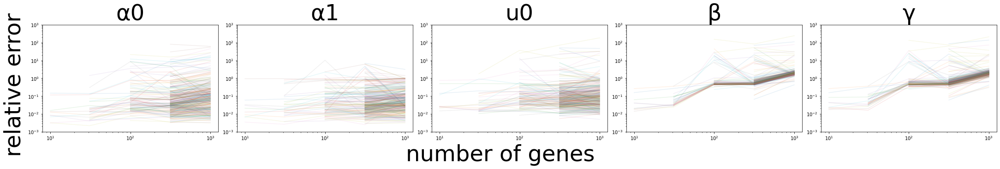

In [108]:
fig = plot_vary_p_results(results_dir+'topo_2_vary_p_2022_m100.pickle')

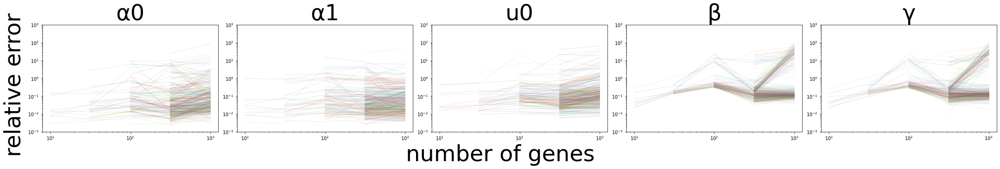

In [109]:
fig = plot_vary_p_results(results_dir+'topo_2_vary_p_2022_m1000.pickle')

In [77]:
fig = plot_vary_p_results(results_dir+'topo_2_vary_p_20221129_m100.pickle')

FileNotFoundError: [Errno 2] No such file or directory: 'benchmarks_ss_results/topo_2_vary_p_20221129.pickle'

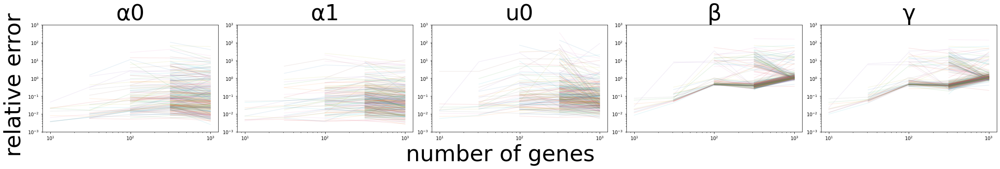

In [76]:
fig = plot_vary_p_results(results_dir+'topo_2_vary_p_20221130.pickle')

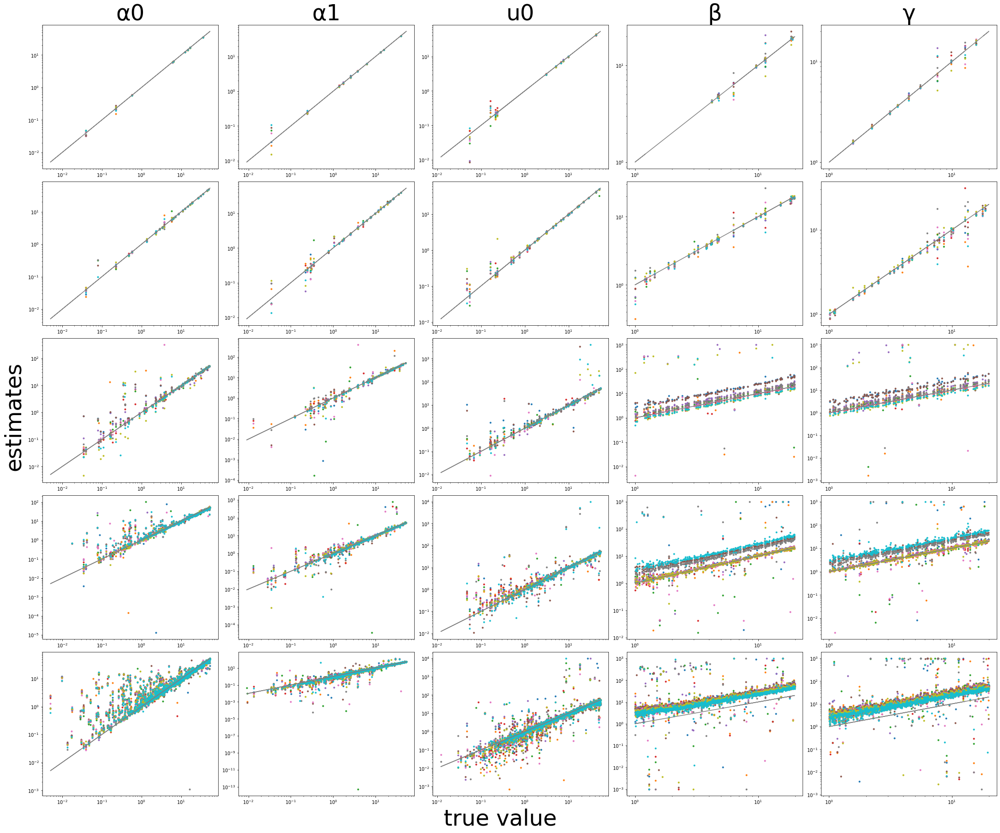

In [112]:
fig = plot_theta_results(results_dir+'topo_2_vary_p_2022_m100.pickle')

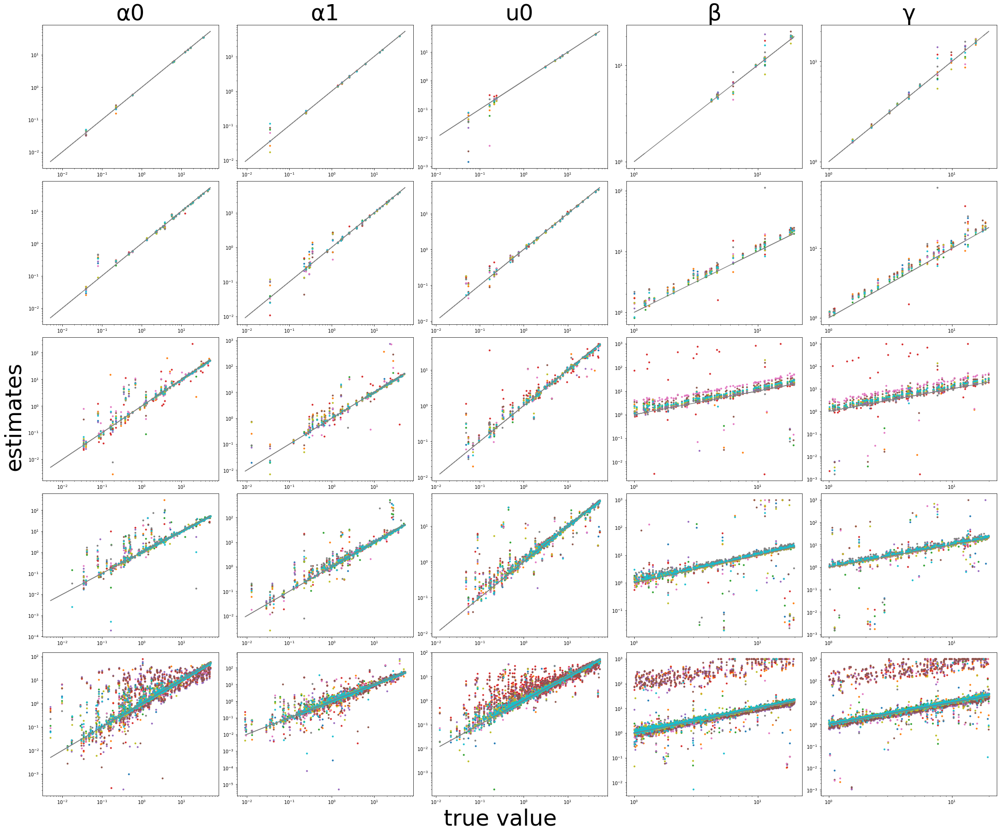

In [113]:
fig = plot_theta_results(results_dir+'topo_2_vary_p_2022_m1000.pickle')

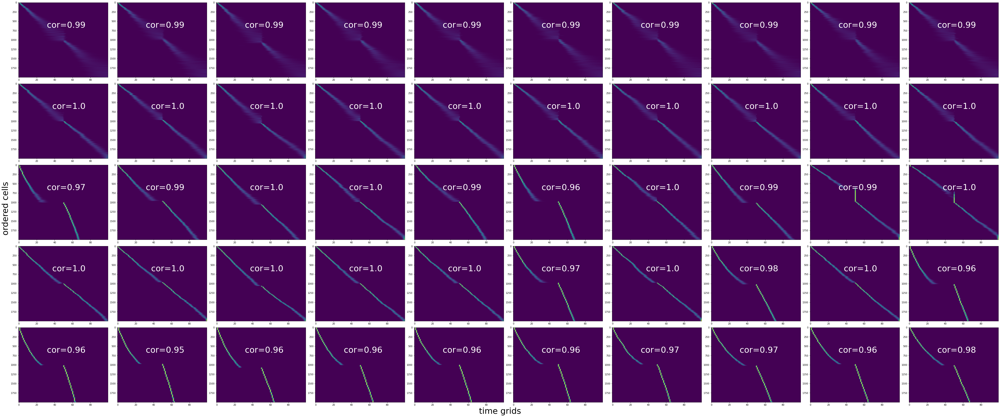

In [25]:
fig = plot_t_results(results_dir+'topo_2_vary_p_2022_m100.pickle')

n_init =  18


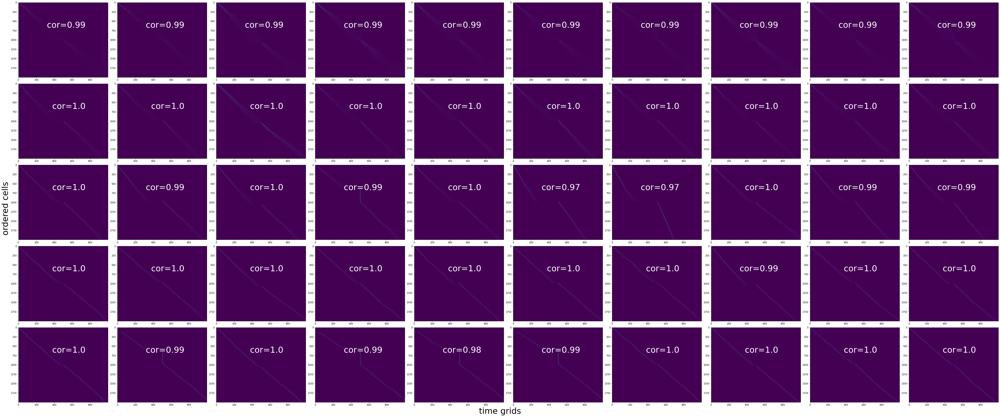

In [26]:
fig = plot_t_results(results_dir+'topo_2_vary_p_2022_m1000.pickle')

In [ ]:
fig = plot_t_results(results_dir+'topo_2_vary_p_20221129.pickle')

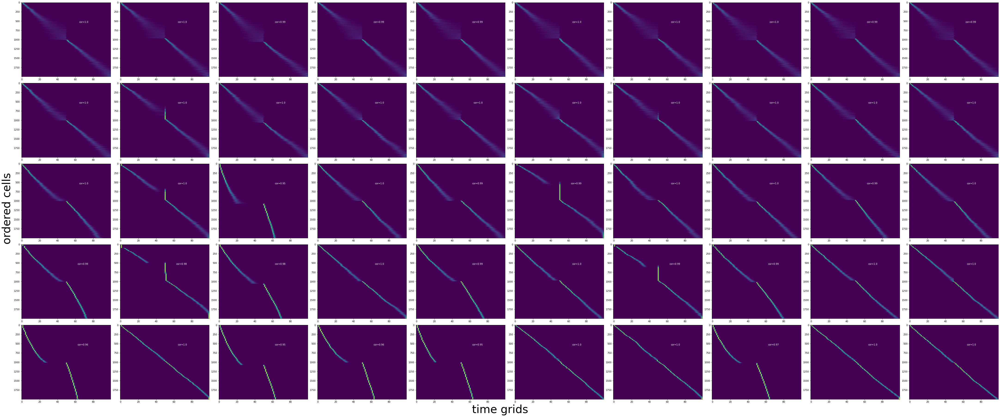

In [78]:
fig = plot_t_results(results_dir+'topo_2_vary_p_20221130.pickle')

## Topo 3 : two lineages (bifurcation)

### vary n

In [161]:
topo = np.array([[0],[1]])
tau = (0,1)
results = fit_vary_n_fixed(topo, tau, ns=[100,316,1000,3162,10000], p=100, seed=2022, K=10, n_init=3, m=100, epoch=100, cores=10)

with open(results_dir+'topo_3_vary_n_2022_m100n5.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

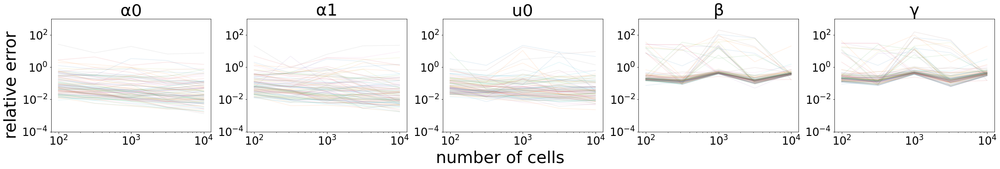

In [190]:
fig = plot_vary_n_results(results_dir+'topo_3_vary_n_2022_m100.pickle',llim=1e-4,hlim=1e3)

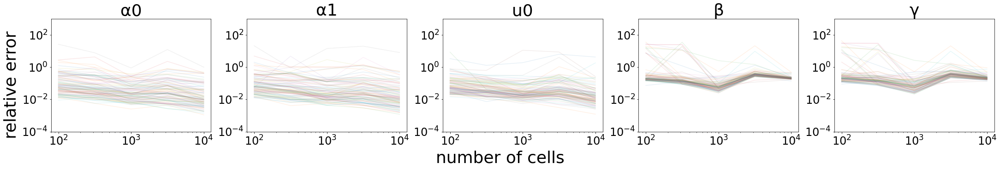

In [196]:
fig = plot_vary_n_results(results_dir+'topo_3_vary_n_2022_m100n5.pickle',llim=1e-4,hlim=1e3)

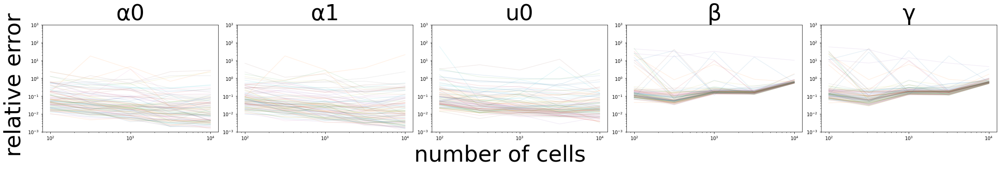

In [80]:
fig = plot_vary_n_results(results_dir+'topo_3_vary_n_20221130_m100.pickle')

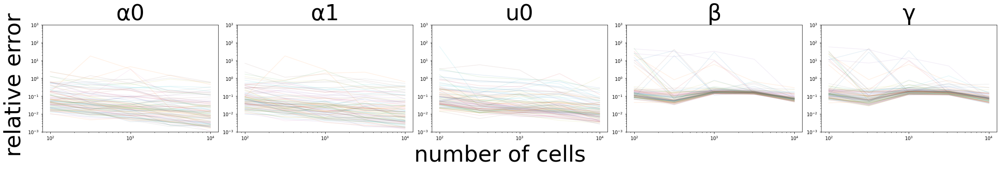

In [115]:
fig = plot_vary_n_results(results_dir+'topo_3_vary_n_20221130_m100n10.pickle')

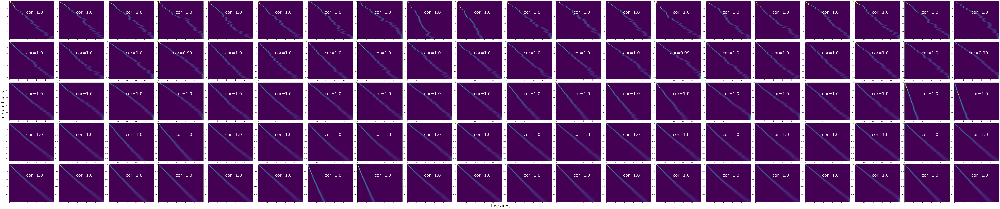

In [27]:
fig = plot_t_results(results_dir+'topo_3_vary_n_2022_m100.pickle')

n_init =  9


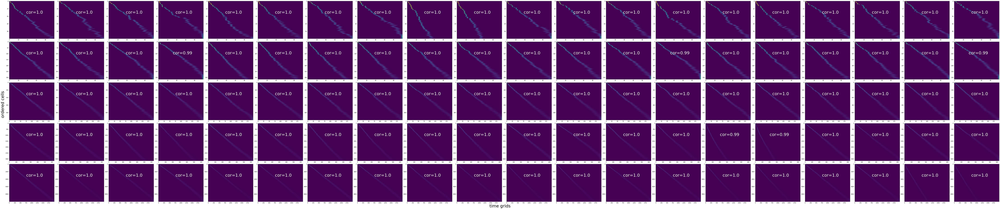

In [28]:
fig = plot_t_results(results_dir+'topo_3_vary_n_2022_m100n5.pickle')

n_init =  9


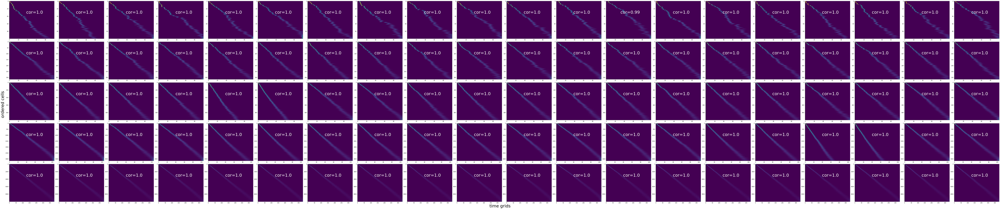

In [29]:
fig = plot_t_results(results_dir+'topo_3_vary_n_20221130_m100n10.pickle')

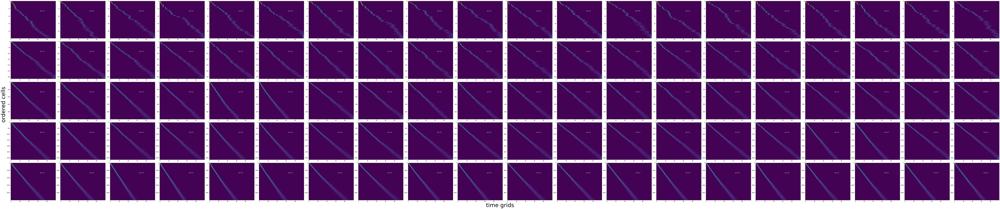

In [82]:
fig = plot_t_results(results_dir+'topo_3_vary_n_20221130.pickle')

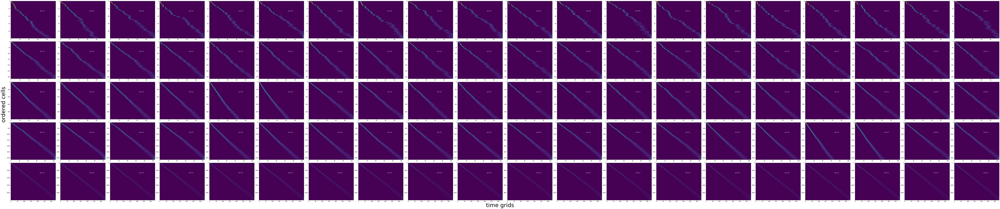

In [122]:
fig = plot_t_results(results_dir+'topo_3_vary_n_20221130_m100n10.pickle')

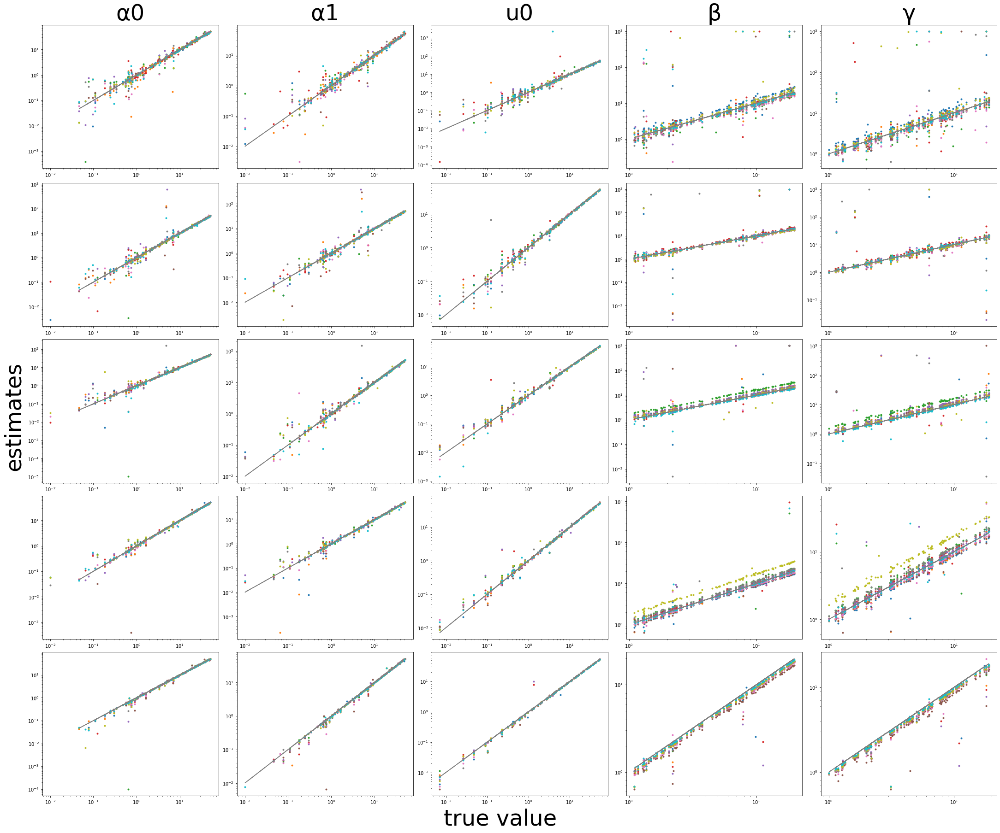

In [121]:
fig = plot_theta_results(results_dir+'topo_3_vary_n_20221130_m100n10.pickle')

### Vary p

In [16]:
topo = np.array([[0],[1]])
tau = (0,1)
results = fit_vary_p_fixed(topo, tau, n=1000, ps=[10,31,100,316,1000], seed=20221130, K=10, n_init=10, m=100, epoch=100, cores=10)

with open(results_dir+'topo_3_vary_p_20221130.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

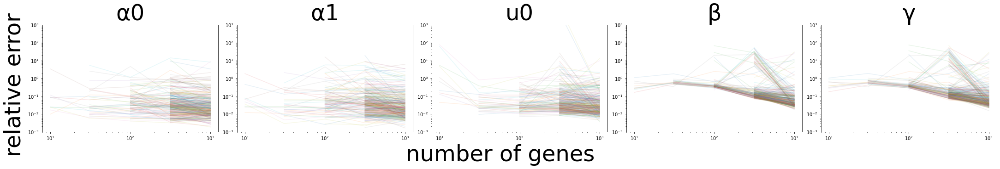

In [42]:
fig = plot_vary_p_results(results_dir+'topo_3_vary_p_2022.pickle')

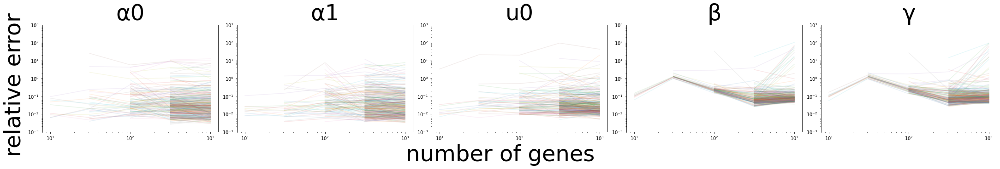

In [43]:
fig = plot_vary_p_results(results_dir+'topo_3_vary_p_20221130.pickle')

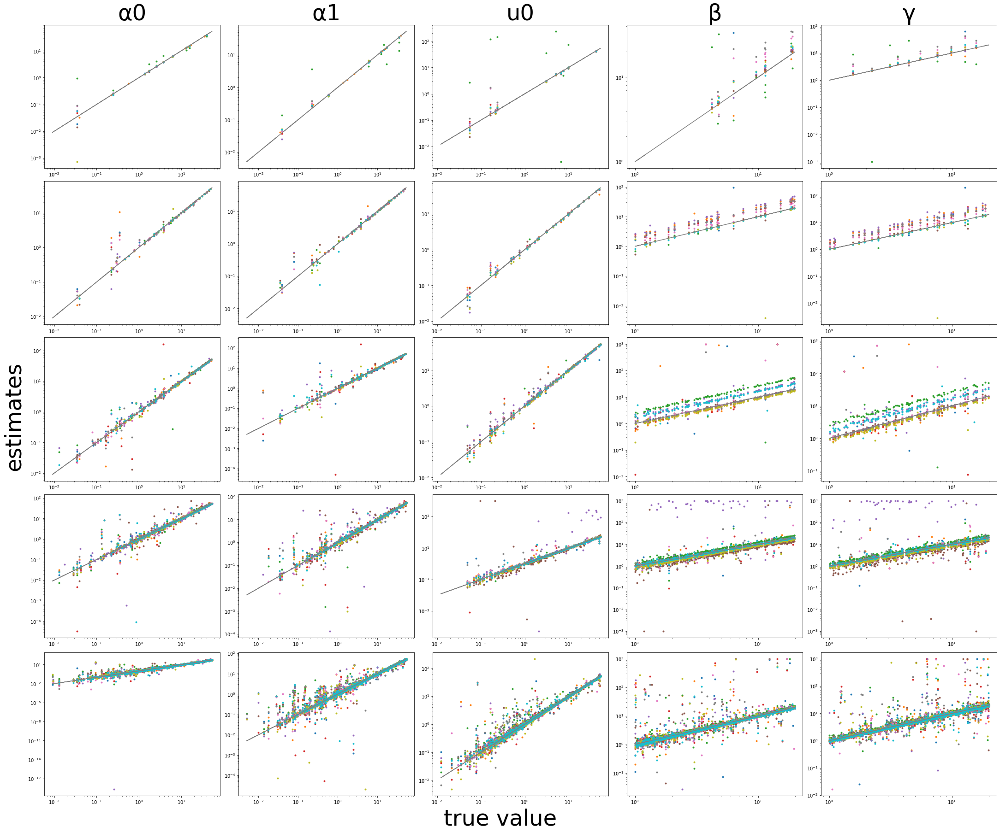

In [44]:
fig = plot_theta_results(results_dir+'topo_3_vary_p_2022.pickle')

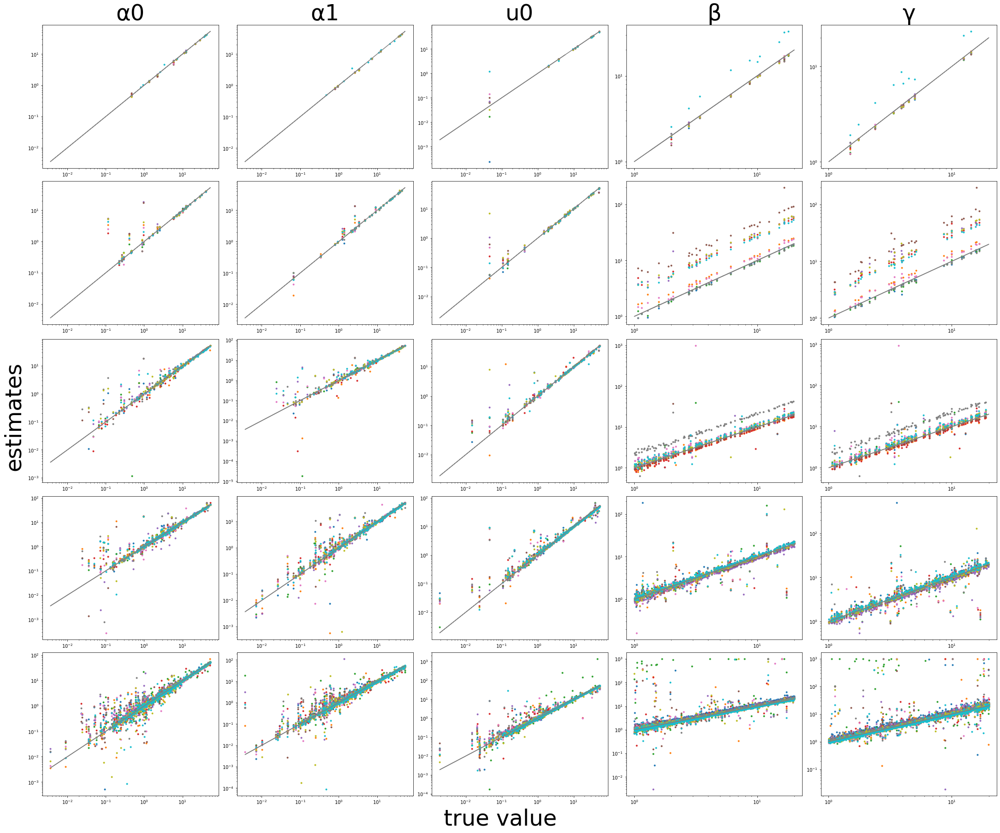

In [47]:
fig = plot_theta_results(results_dir+'topo_3_vary_p_20221130.pickle')

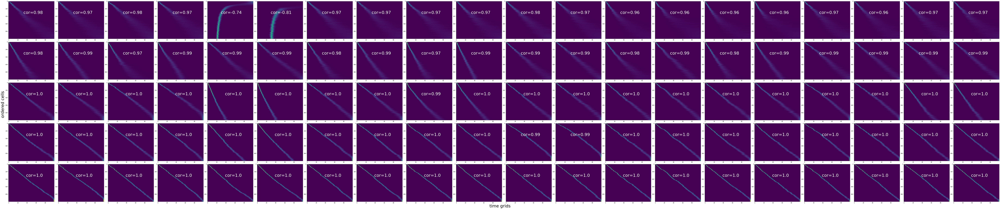

In [30]:
fig = plot_t_results(results_dir+'topo_3_vary_p_2022_m100.pickle')

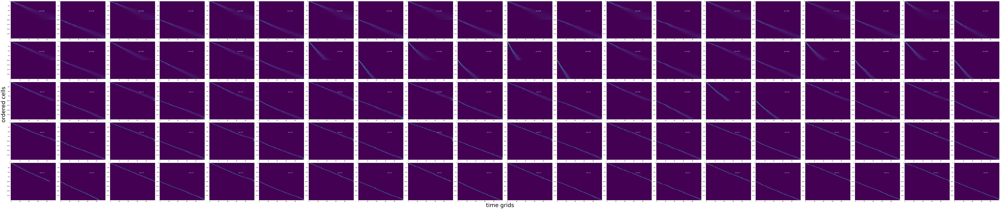

In [45]:
fig = plot_t_results(results_dir+'topo_3_vary_p_20221130_m100.pickle')

# Model selection

## null genes

In [18]:
import numpy as np

def simulate_data_with_null(topo, tau, n, p, null = 0.5, loga_max=4, logb_max=2, random_seed=42):
    np.random.seed(random_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    t=np.linspace(tau[0],tau[-1],n)
    true_t = []
    
    theta=np.zeros((p,n_states+4))
    for j in range(n_states+2):
        theta[:,j]=np.exp(np.random.uniform(0,loga_max,size=p))-1
    theta[:,-2]=np.exp(np.random.uniform(0,logb_max,size=p))
    theta[:,-1]=np.exp(np.random.uniform(0,logb_max,size=p))

    null_p = int(p*null)
    theta[:null_p,1]=theta[:null_p,0]
    theta[:null_p,-4]=theta[:null_p,0]
    theta[:null_p,-2]=1
    theta[:null_p,-1]=theta[:null_p,-4]/theta[:null_p,-3]

    Y = np.zeros((n*L,p,2))
    for l in range(L):
        theta_l = np.concatenate((theta[:,topo[l]], theta[:,-4:]), axis=1)
        Y[l*n:(l+1)*n] = get_Y(theta_l,t,tau) # m*p*2
        true_t = np.append(true_t,t)

    X = np.random.poisson(Y)
    return theta, true_t, Y, X

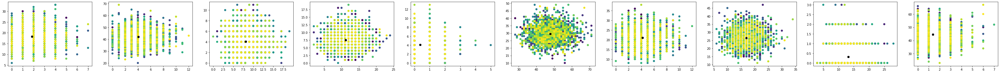

In [21]:
#%% generate data
topo = np.array([[0]])
tau = (0,1)
true_theta, t, Y, X = simulate_data_with_null(topo,tau,n=2000,p=200,random_seed=2023)

t = np.linspace(0,1,2000)
plot_p = 10
fig, ax = plt.subplots(1,plot_p,figsize=(6*plot_p,4))
for i in range(plot_p):
    j = 90 + i
    ax[i].scatter(X[:,j,0],X[:,j,1],c=t);
    ax[i].scatter(Y[:,j,0],Y[:,j,1],c='black');


In [20]:
traj = Trajectory(topo, tau)
res = traj.fit_multi_init(X,100,n_init=2,epoch=10,parallel=True,n_threads=2)

trial 1


100%|██████████| 10/10 [00:20<00:00,  2.08s/it]

trial 2



100%|██████████| 10/10 [00:17<00:00,  1.73s/it]


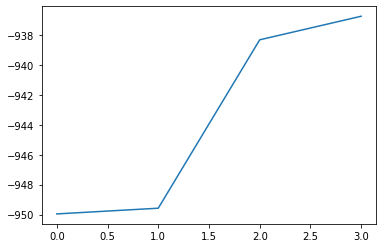

In [22]:
Q, elbos = res
plt.plot(elbos);

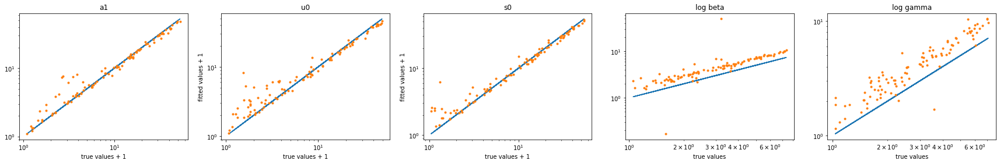

In [23]:
plot_theta(true_theta[100:],traj.theta[100:])

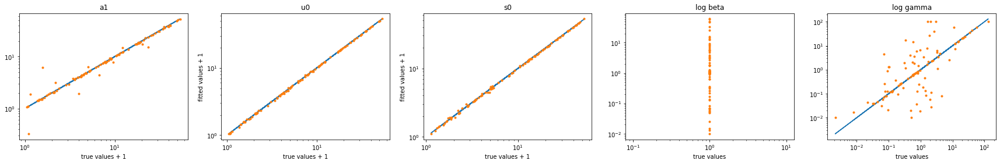

In [24]:
plot_theta(true_theta[:100],traj.theta[:100])

In [ ]:
plot_phase(X,traj.theta[:20],Q,topo,tau)

In [25]:
accepts = []
diffs = []
true_positive = 0
for j in range(100):
    nested_model = {j:[[0,-3],[-4,-4]]}
    accept, diff = traj.compare_model(X, nested_model)
    true_positive += accept
    accepts.append(accept)
    diffs.append(diff)


In [28]:
accepts = []
diffs = []
false_positive = 0
for j in range(100,200):
    nested_model = {j:[[0,-3],[-4,-4]]}
    accept, diff = traj.compare_model(X, nested_model)
    false_positive += accept
    accepts.append(accept)
    diffs.append(diff)


In [29]:
true_positive,false_positive

(95, 0)

## Partially changing genes

In [ ]:
import numpy as np

def simulate_data_with_partial_null(topo, tau, n, p, null_p = 10, loga_max=4, logb_max=2, random_seed=42):
    np.random.seed(random_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    assert n_states > 1
    t=np.linspace(tau[0],tau[-1],n)
    true_t = []
    
    theta=np.zeros((p,n_states+4))
    for j in range(n_states+2):
        theta[:,j]=np.exp(np.random.uniform(0,loga_max,size=p))-1
    theta[:,-2]=np.exp(np.random.uniform(0,logb_max,size=p))
    theta[:,-1]=np.exp(np.random.uniform(0,logb_max,size=p))

    theta[:null_p,1]=theta[:null_p,0]

    Y = np.zeros((n*L,p,2))
    for l in range(L):
        theta_l = np.concatenate((theta[:,topo[l]], theta[:,-4:]), axis=1)
        Y[l*n:(l+1)*n] = get_Y(theta_l,t,tau) # m*p*2
        true_t = np.append(true_t,t)

    X = np.random.poisson(Y)
    return theta, true_t, Y, X

In [ ]:
#%% generate data
topo = np.array([[0,1]])
tau = (0,0.5,1)
true_theta, t, Y, X = simulate_data_with_partial_null(topo,tau,n=2000,p=100,random_seed=2023)

p = 20
fig, ax = plt.subplots(1,p,figsize=(6*p,4))
for i in range(p):
    ax[i].set_title(str(i));
    ax[i].scatter(X[:,i,0],X[:,i,1],c=t);
    ax[i].scatter(Y[:,i,0],Y[:,i,1],c='black');
# time increases from blue to yellow

In [ ]:
traj = Trajectory(topo, tau)
res = traj.fit_multi_init(X,100,n_init=10,epoch=10,parallel=True,n_threads=2)

In [ ]:
Q, elbos, thetas = res
plt.plot(elbos);

In [ ]:
plot_theta(true_theta[10:],traj.theta[10:])

In [ ]:
plot_phase(X,traj.theta[:20],Q,topo,tau)

In [ ]:
accepts = []
diffs = []
for j in range(20):
    nested_model = {j:[[1],[0]]}
    accept, diff = traj.compare_model(X, nested_model, parallel=True, n_threads=2)
    accepts.append(accept)
    diffs.append(diff)

In [ ]:
plt.plot(accepts);

In [ ]:
plot_phase(X,traj.new_theta[:20],Q,topo,tau)

In [ ]:
plt.plot(diffs)